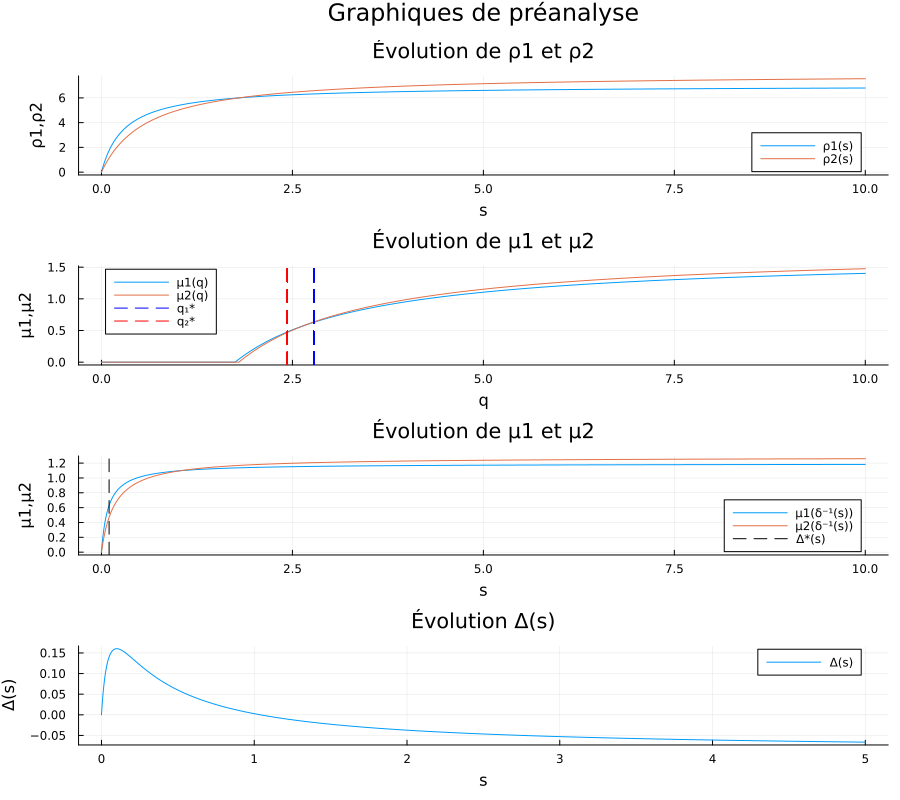

qmax1: 5.86764705882353
qmax2: 6.2444444444444445


"/home/ulricjean/Documents/PFE-Microalgues/préanalyse_droop.pdf"

In [3]:
using Plots

# Paramètres
Tmax = 50
Dmax = 1.5

sin = 10
Δs = 0.0001
qs = 0.0001
s_final = 10
q_final = 10

ρmax1 = 7
ρmax2 = 8

Ks1 = 0.3
Ks2 = 0.6

μ_barre1 = 1.7
μ_barre2 = 1.8

Q01 = 1.75
Q02 = 1.8

qmax1 = Q01 + ( ρmax1 / μ_barre1 )
qmax2 = Q02 + ( ρmax2 / μ_barre2 )

print("qmax1: ",qmax1,"\n")
print("qmax2: ",qmax2,"\n")

# Define N (time steps)
N = 750 #4000 #750 2500 <- stable

# Définition des fonctions μ1_s et μ2_s
function μ1_s(s)
    return ρmax1 * μ_barre1 * s / (Ks1 * Q01 * μ_barre1 + (ρmax1 + μ_barre1 * Q01) * s)
end
function μ2_s(s)
    return ρmax2 * μ_barre2 * s / (Ks2 * Q02 * μ_barre2 + (ρmax2 + μ_barre2 * Q02) * s)
end
function ρ1_s(s)
    return ρmax1 * (s / (Ks1 + s))
end
function ρ2_s(s)
    return ρmax2 * (s / (Ks2 + s))
end

# Ne pas déclarer les fonctions comme ca
function μ1_q(q)
    if q < Q01
        return 0
    else
        return μ_barre1 * (1 - Q01 / q)
    end
end
function μ2_q(q)
    if q < Q02
        return 0
    else
        return μ_barre2 * (1 - Q02 / q)
    end
end


# Définir les valeurs de s
s_values = 0:Δs:s_final
q_values = 0:qs:q_final

# Calcul des valeurs pour μ1 et μ2
μ1_values = μ1_s.(s_values) 
μ2_values = μ2_s.(s_values)

# Calcul des valeurs pour ρ1 et ρ2
ρ1_values = ρ1_s.(s_values) 
ρ2_values = ρ2_s.(s_values)

# Calcul des valeurs pour μ1_q et μ2_q
μ1_q_values = μ1_q.(q_values) 
μ2_q_values = μ2_q.(q_values)

# Autres Calcul 
s_barre = s_values[argmax(μ1_values-μ2_values)]
s_sol_vec = ones(N+1) * s_barre
q1_sol_vec = ones(N+1) * ( ( ρmax1 / μ_barre1 ) * ( s_barre / ( s_barre + Ks1 ) ) + Q01 ) 
q2_sol_vec = ones(N+1) * ( ( ρmax2 / μ_barre2 ) * ( s_barre / ( s_barre + Ks2 ) ) + Q02 )

# Tracés
μ0_plot = plot(s_values, ρ1_values, xlabel = "s", ylabel = "ρ1,ρ2", label = "ρ1(s)", title = "Évolution de ρ1 et ρ2")
plot!(s_values, ρ2_values, label = "ρ2(s)")

μ3_plot = plot(q_values, μ1_q_values, xlabel = "q", ylabel = "μ1,μ2", label = "μ1(q)", title = "Évolution de μ1 et μ2")
plot!(q_values, μ2_q_values, label = "μ2(q)")
vline!([q1_sol_vec], label = "q₁*",linestyle=:dash,color=:blue)  
vline!([q2_sol_vec], label = "q₂*",linestyle=:dash,color=:red) 

μ1_plot = plot(s_values, μ1_values, xlabel = "s", ylabel = "μ1,μ2", label = "μ1(δ⁻¹(s))", title = "Évolution de μ1 et μ2")
plot!(s_values, μ2_values, label = "μ2(δ⁻¹(s))")
vline!([s_barre], label = "Δ*(s)",linestyle=:dash,color=:black)  

μ2_plot = plot(s_values[1:div(end, 2)], μ1_values[1:div(end, 2)]-μ2_values[1:div(end, 2)], xlabel = "s", ylabel = "Δ(s)", label = "Δ(s)", title = "Évolution Δ(s)")

# Affichage du graphique
#display(μ0_plot)
#display(μ3_plot)
#display(μ1_plot)
#display(μ2_plot)

μ5_plot =  plot(μ0_plot, μ3_plot, μ1_plot, μ2_plot, size = (900, 800), layout = (4,1), plot_title="Graphiques de préanalyse")
display(μ5_plot)
savefig(μ5_plot, "préanalyse_droop.pdf")

In [2]:
using JuMP, Ipopt, Plots, MINPACK

# JuMP model, Ipopt solver
sys = Model(optimizer_with_attributes(Ipopt.Optimizer, "print_level" => 10))
set_optimizer_attribute(sys, "tol", 1e-3)
set_optimizer_attribute(sys, "constr_viol_tol", 1e-3)
set_optimizer_attribute(sys, "max_iter", 1000)
set_optimizer_attribute(sys, "check_derivatives_for_naninf", "yes")

# Variables (some state constraints have been added to ease convergence)
@variables(sys, begin
    Δt == Tmax / N

    0.0 ≤ s[1:N+1] ≤ sin
    
    0.0 ≤ x1[1:N+1]
    0.0 ≤ x2[1:N+1]

    Q01 ≤ q1[1:N+1] ≤ qmax1
    Q02 ≤ q2[1:N+1] ≤ qmax2

    0.0 ≤ D[1:N+1] ≤ Dmax
end)

# Ajout pour le schéma
@variables(sys, begin
    s̄[1:N]  # Valeur intermédiaire de s
    q̄1[1:N]
    x̄1[1:N]
    q̄2[1:N]
    x̄2[1:N]
end)



# Objective
ϵ = 0.0001
@NLobjective(sys, Max, (x1[N+1]+ϵ)/(x2[N+1]+ϵ))


# Boundary constraints
@constraints(sys, begin
    con_s_init, s[1] == 4

    con_x1_init, x1[1] == 0.3
    con_x2_init, x2[1] == 0.3

    con_q1_init, q1[1] == 1.9
    con_q2_init, q2[1] == 1.9
end)


# Functions
function μ1(q)
    return μ_barre1 * (1 - Q01 / q)
end


function ρ1(s)
    return ρmax1 * (s / (Ks1 + s))
end


function μ2(q)
    return μ_barre2 * (1 - Q02 / q)
end


function ρ2(s)
    return ρmax2 * (s / (Ks2 + s))
end

function D_analytique(x1, x2)
    s_opt = s_barre[1]
    return (ρ1(s_opt) * x1 + ρ2(s_opt) * x2) / (sin - s_opt)
end

# Register the functions for automatic differentiation
register(sys, :μ1, 1, μ1; autodiff = true)
register(sys, :ρ1, 1, ρ1; autodiff = true)
register(sys, :μ2, 1, μ2; autodiff = true)
register(sys, :ρ2, 1, ρ2; autodiff = true)
register(sys, :D_analytique, 2, D_analytique; autodiff = true)

# Dynamics (nonlinear expressions)
@NLexpressions(sys, begin
    # s
    ds[i = 1:N+1], D[i] * (sin - s[i]) - ρ1(s[i]) * x1[i] - ρ2(s[i]) * x2[i]
    
    # q1
    dq1[i = 1:N+1], ρ1(s[i]) - μ1(q1[i]) * q1[i]
    
    # x1
    dx1[i = 1:N+1], μ1(q1[i]) * x1[i] - D[i] * x1[i]
    
    # q2
    dq2[i = 1:N+1], ρ2(s[i]) - μ2(q2[i]) * q2[i]
    
    # x2
    dx2[i = 1:N+1], μ2(q2[i]) * x2[i] - D[i] * x2[i]
end)

# Ajouter une contrainte explicite sur D pour éviter les valeurs négatives
@constraints(sys, begin
    con_D_pos[i = 1:N+1], Dmax >= D[i] >= 0
end)


# Crank-Nicolson scheme (nonlinear constraints)
@NLconstraints(sys, begin
    con_ds[i = 1:N], s[i+1] == s[i] + Δt * (ds[i] + ds[i+1]) / 2.0
    con_dq1[i = 1:N], q1[i+1] == q1[i] + Δt * (dq1[i] + dq1[i+1]) / 2.0
    con_dx1[i = 1:N], x1[i+1] == x1[i] + Δt * (dx1[i] + dx1[i+1]) / 2.0
    con_dq2[i = 1:N], q2[i+1] == q2[i] + Δt * (dq2[i] + dq2[i+1]) / 2.0
    con_dx2[i = 1:N], x2[i+1] == x2[i] + Δt * (dx2[i] + dx2[i+1]) / 2.0
end)

# Solve the optimization problem
println("Solving...")
status = optimize!(sys)

# Check the results
if termination_status(sys) == MOI.OPTIMAL
    println("Solution is optimal")
elseif termination_status(sys) == MOI.LOCALLY_SOLVED
    println("Local solution found")
elseif termination_status(sys) == MOI.TIME_LIMIT && has_values(sys)
    println("Solution is suboptimal due to a time limit, but a primal solution is available")
else
    error("The model was not solved correctly.")
end
println("Objective value = ", objective_value(sys), "\n")

# Retrieve values (including duals)
Δtt = value.(Δt)
t = (1:N+1) * Δtt
t = (t[1:end-1] + t[2:end]) / 2.0  # Calcul des temps moyens

p = -[ [ dual(con_ds[i]), dual(con_dx1[i]), dual(con_dx2[i]), dual(con_dq1[i]), dual(con_dq2[i]) ] for i in 1:N ]

Solving...

List of options:

                                    Name   Value                # times used
            check_derivatives_for_naninf = yes                       1
                         constr_viol_tol = 0.001                     5
                   hessian_approximation = limited-memory            7
                                max_iter = 1000                      1
                      obj_scaling_factor = -1                        1
                             print_level = 10                        2
                                     tol = 0.001                     2

******************************************************************************
This program contains Ipopt, a library for large-scale nonlinear optimization.
 Ipopt is released as open source code under the Eclipse Public License (EPL).
         For more information visit https://github.com/coin-or/Ipopt
******************************************************************************

This is I

750-element Vector{Vector{Float64}}:
 [-91.9444397304878, 7236.06775688857, -6426.566963533431, 361.6378352182547, -357.6746128112194]
 [-89.79646772162721, 7005.520323226766, -6296.159622788609, 318.166060156251, -320.77758975441697]
 [-87.60344538064572, 6704.943709347592, -6089.513425190777, 291.2729869064035, -299.9526405344678]
 [-85.2378837993044, 6366.484766050581, -5839.095417826565, 274.3549190852676, -288.69875751089455]
 [-82.56781531927626, 6010.274917473893, -5564.893452336009, 264.0549138746693, -283.82083428466143]
 [-79.42673805947786, 5649.464824723439, -5279.724737500148, 258.50405005983765, -283.5874702738727]
 [-75.57781602105003, 5292.901130893368, -4991.956667731526, 256.591970078147, -286.99424700588963]
 [-70.65704881880978, 4946.697239734118, -4707.031730848152, 257.62413401372334, -293.42548033840484]
 [-64.07356693295232, 4615.245413349305, -4428.379171032207, 261.1415342744352, -302.47758960945316]
 [-54.8380818269783, 4301.938648657031, -4158.004568136941, 

In [3]:

#=
using JuMP, Ipopt, Plots, MINPACK

# JuMP model, Ipopt solver
sys = Model(optimizer_with_attributes(Ipopt.Optimizer, "print_level" => 10))
set_optimizer_attribute(sys, "tol", 1e-3)
set_optimizer_attribute(sys, "constr_viol_tol", 1e-3)
set_optimizer_attribute(sys, "max_iter", 1000)
set_optimizer_attribute(sys, "check_derivatives_for_naninf", "yes")

# Constants (Ensure these are defined before use)
Tmax = 10.0
N = 50
sin = 5.0
Q01, Q02 = 0.1, 0.1
qmax1, qmax2 = 5.0, 5.0
Dmax = 2.0
μ_barre1, μ_barre2 = 0.5, 0.5
ρmax1, ρmax2 = 0.3, 0.3
Ks1, Ks2 = 0.1, 0.1

# Functions
function μ1(q)
    return μ_barre1 * (1 - Q01 / q)
end

function ρ1(s)
    return ρmax1 * (s / (Ks1 + s))
end

function μ2(q)
    return μ_barre2 * (1 - Q02 / q)
end

function ρ2(s)
    return ρmax2 * (s / (Ks2 + s))
end

# Register functions for autodiff
register(sys, :μ1, 1, μ1; autodiff = true)
register(sys, :ρ1, 1, ρ1; autodiff = true)
register(sys, :μ2, 1, μ2; autodiff = true)
register(sys, :ρ2, 1, ρ2; autodiff = true)

# Variables
@variables(sys, begin
    Δt == Tmax / N
    0.0 ≤ s[1:N+1] ≤ sin
    0.0 ≤ x1[1:N+1]
    0.0 ≤ x2[1:N+1]
    Q01 ≤ q1[1:N+1] ≤ qmax1
    Q02 ≤ q2[1:N+1] ≤ qmax2
    0.0 ≤ D[1:N+1] ≤ Dmax
    s̄[1:N]
    q̄1[1:N]
    x̄1[1:N]
    q̄2[1:N]
    x̄2[1:N]
end)

# Objective
ϵ = 0.0001
@NLobjective(sys, Max, (x1[N+1]+ϵ)/(x2[N+1]+ϵ))

# Initial conditions
@constraints(sys, begin
    s[1] == 2
    x1[1] == 1
    x2[1] == 1
    q1[1] == 2
    q2[1] == 2
end)

# Gauss-Legendre midpoint rule
@NLconstraints(sys, begin
    con_s_mid[i = 1:N],  s̄[i]  == s[i]  + (Δt / 2) * (D[i] * (sin - s[i]) - ρ1(s[i]) * x1[i] - ρ2(s[i]) * x2[i])
    con_q1_mid[i = 1:N], q̄1[i] == q1[i] + (Δt / 2) * (ρ1(s[i]) - μ1(q1[i]) * q1[i])
    con_x1_mid[i = 1:N], x̄1[i] == x1[i] + (Δt / 2) * (μ1(q1[i]) * x1[i] - D[i] * x1[i])
    con_q2_mid[i = 1:N], q̄2[i] == q2[i] + (Δt / 2) * (ρ2(s[i]) - μ2(q2[i]) * q2[i])
    con_x2_mid[i = 1:N], x̄2[i] == x2[i] + (Δt / 2) * (μ2(q2[i]) * x2[i] - D[i] * x2[i])
end)

# Compute derivatives at intermediate points
@NLexpressions(sys, begin
    ds̄[i = 1:N], D[i] * (sin - s̄[i]) - ρ1(s̄[i]) * x̄1[i] - ρ2(s̄[i]) * x̄2[i]
    dq̄1[i = 1:N], ρ1(s̄[i]) - μ1(q̄1[i]) * q̄1[i]
    dx̄1[i = 1:N], μ1(q̄1[i]) * x̄1[i] - D[i] * x̄1[i]
    dq̄2[i = 1:N], ρ2(s̄[i]) - μ2(q̄2[i]) * q̄2[i]
    dx̄2[i = 1:N], μ2(q̄2[i]) * x̄2[i] - D[i] * x̄2[i]
end)

# Update states with Gauss-Legendre method
@NLconstraints(sys, begin
    con_ds[i = 1:N],  s[i+1]  == s[i]  + Δt * ds̄[i]
    con_dq1[i = 1:N], q1[i+1] == q1[i] + Δt * dq̄1[i]
    con_dx1[i = 1:N], x1[i+1] == x1[i] + Δt * dx̄1[i]
    con_dq2[i = 1:N], q2[i+1] == q2[i] + Δt * dq̄2[i]
    con_dx2[i = 1:N], x2[i+1] == x2[i] + Δt * dx̄2[i]
end)

# Solve the optimization problem
println("Solving...")
status = optimize!(sys)

# Vérification plus détaillée des résultats
term_status = termination_status(sys)
println("Termination status: ", term_status)

if term_status == MOI.OPTIMAL
    println("Solution optimale trouvée")
    println("Objective value = ", objective_value(sys))
    
    # Récupération des valeurs uniquement si la solution est valide
    Δtt = value.(Δt)
    t = [i*Δtt for i in 0:N]
    
    s_val = value.(s)
    x1_val = value.(x1)
    x2_val = value.(x2)
    q1_val = value.(q1)
    q2_val = value.(q2)
    D_val = value.(D)
    
    # Affichage des résultats
    plot(t, s_val, label="s(t)")
    plot!(t, x1_val, label="x1(t)")
    plot!(t, x2_val, label="x2(t)")
    plot!(t, D_val, label="D(t)")
    
elseif term_status in [MOI.LOCALLY_SOLVED, MOI.ALMOST_LOCALLY_SOLVED]
    println("Solution locale trouvée")
    println("Valeur objective = ", objective_value(sys))
    
elseif term_status == MOI.TIME_LIMIT && has_values(sys)
    println("Temps dépassé mais solution disponible")
    println("Valeur objective = ", objective_value(sys))
    
else
    # Afficher plus d'infos de débogage
    println("Statut de terminaison: ", term_status)
    println("Message du solveur: ", primal_status(sys))
    
    # Vérifier l'incohérence des contraintes
    if term_status == MOI.INFEASIBLE
        println("Problème potentiellement infaisable - vérifiez les contraintes")
        # Vous pouvez ajouter une vérification d'incohérence ici
    end
end

# Retrieve values
Δtt = value.(Δt)
t = (1:N+1) * Δtt
t = (t[1:end-1] + t[2:end]) / 2.0  # Compute mean times

p = -[ [ dual(con_ds[i]), dual(con_dx1[i]), dual(con_dx2[i]), dual(con_dq1[i]), dual(con_dq2[i]) ] for i in 1:N ]
=#

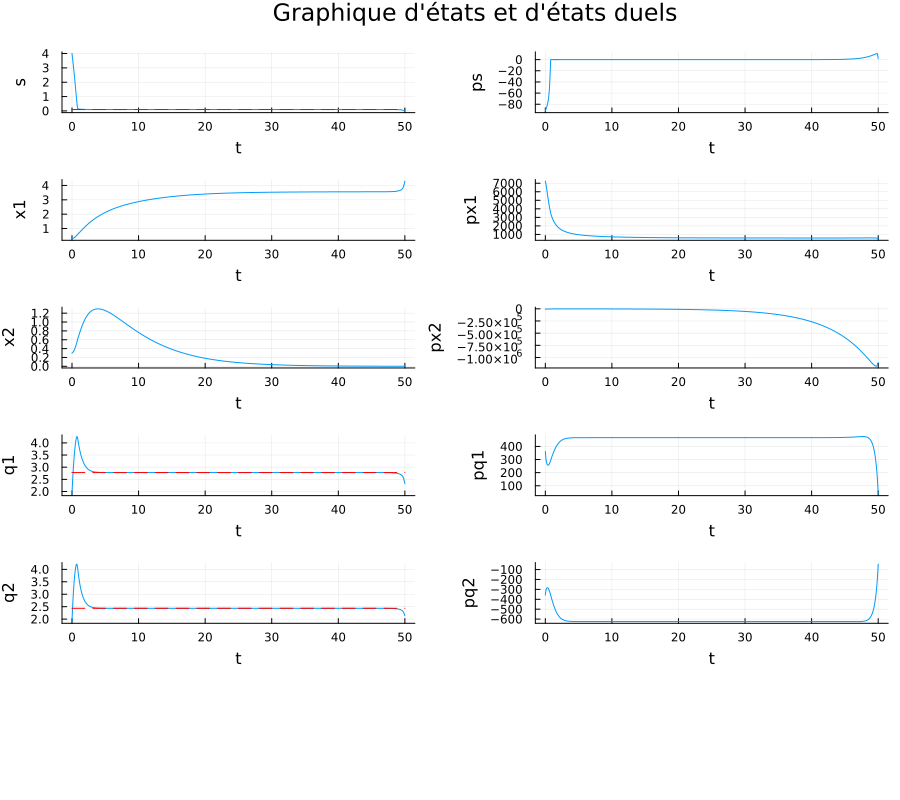

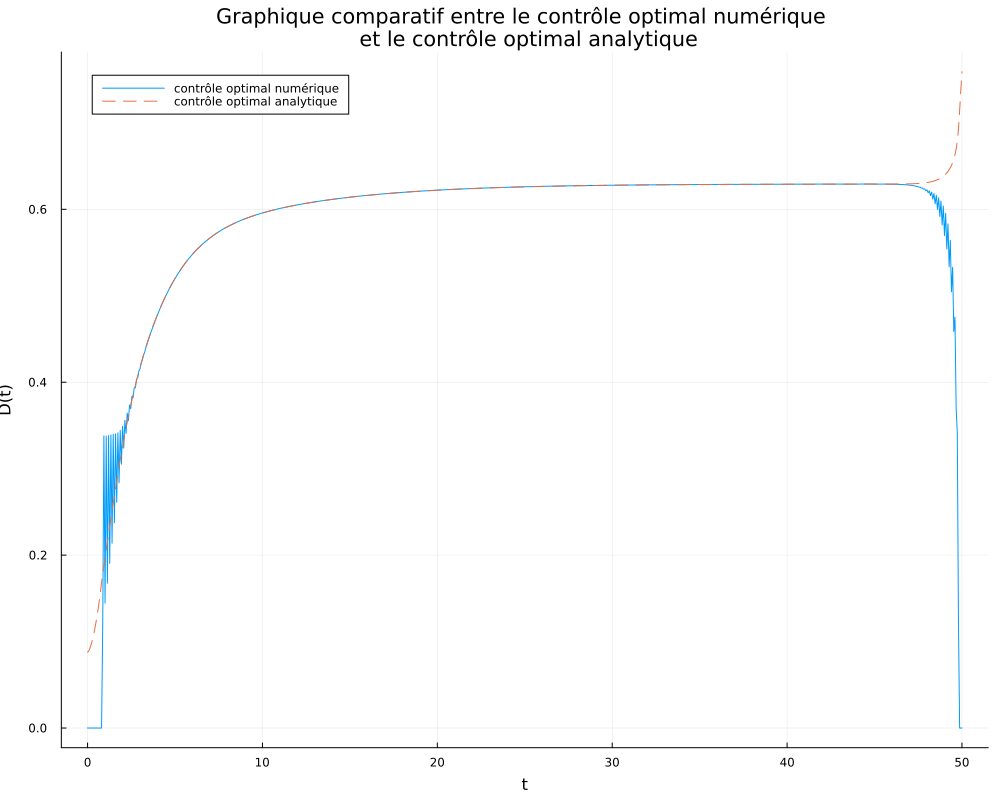

"/home/ulricjean/Documents/PFE-Microalgues/control_plots.pdf"

In [12]:
using Plots

# Calcul du vecteur de temps (t) sur N+1 points
t = LinRange(0, Tmax, N+1)
tp = LinRange(0, Tmax, N)

# Variables d'état et de contrôle
s_values = value.(s)

D_values = value.(D)

x1_values = value.(x1)
x2_values = value.(x2)

q1_values = value.(q1)
q2_values = value.(q2)

D_values_analytique = D_analytique.(x1_values[1:N+1], x2_values[1:N+1])

# Plots: state, adjoint state, and control
D_plot1 = plot(t, D_values[1:N+1], xlabel = "t", ylabel = "D", legend = false)

D_plot2 = plot(t, D_values[1:N+1], xlabel = "t", ylabel = "D(t)", title="Graphique comparatif entre le contrôle optimal numérique \n et le contrôle optimal analytique", label="contrôle optimal numérique", legend = :topleft)
plot!(t,D_values_analytique[1:N+1],linestyle=:dash,label="contrôle optimal analytique",legend=:topleft)

s_plot = plot(t, s_values[1:N+1], xlabel = "t", ylabel = "s", legend = false)
plot!(t, s_sol_vec[1:N+1], label = "s optimal", color = :red, linestyle = :dash)

x1_plot = plot(t, x1_values[1:N+1], xlabel = "t", ylabel = "x1", legend = false)
x2_plot = plot(t, x2_values[1:N+1], xlabel = "t", ylabel = "x2", legend = false)

q1_plot = plot(t, q1_values[1:N+1], xlabel = "t", ylabel = "q1", legend = false)
plot!(t, q1_sol_vec[1:N+1], label = "q1 optimal", color = :red, linestyle = :dash)
q2_plot = plot(t, q2_values[1:N+1], xlabel = "t", ylabel = "q2", legend = false)
plot!(t, q2_sol_vec[1:N+1], label = "q1 optimal", color = :red, linestyle = :dash)

s_dual_plot = plot(tp, [ p[i][1] for i in 1:N ], xlabel = "t", ylabel = "ps", legend = false)

x1_dual_plot = plot(tp, [ p[i][2] for i in 1:N ], xlabel = "t", ylabel = "px1", legend = false)
x2_dual_plot = plot(tp, [ p[i][3] for i in 1:N ], xlabel = "t", ylabel = "px2", legend = false)

q1_dual_plot = plot(tp, [ p[i][4] for i in 1:N ], xlabel = "t", ylabel = "pq1", legend = false)
q2_dual_plot = plot(tp, [ p[i][5] for i in 1:N ], xlabel = "t", ylabel = "pq2", legend = false)


# Combine plots into a layout
state_plot = plot(s_plot, s_dual_plot, x1_plot, x1_dual_plot, x2_plot, x2_dual_plot, q1_plot, q1_dual_plot, q2_plot, q2_dual_plot, size = (900, 800), layout = (7,2), plot_title="Graphique d'états et d'états duels")

control_plot1 = plot(D_plot1, size = (1000, 800), layout = (1,1))
control_plot2 = plot(D_plot2, size = (1000, 800), layout = (1,1))

# Display and save the plots
display(state_plot)
savefig(state_plot, "state_plots.pdf")

#display(control_plot1)

display(control_plot2)
savefig(control_plot2, "control_plots.pdf")
